In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pymc3 as pm

import altair as alt
import arviz as az
alt.data_transformers.disable_max_rows()

/home/corrie/.pyenv/versions/anaconda3-2019.03/lib/python3.7/site-packages/xarray/core/merge.py:17: FutureWarning: The Panel class is removed from pandas. Accessing it from the top-level namespace will also be removed in the next version
  PANDAS_TYPES = (pd.Series, pd.DataFrame, pd.Panel)


DataTransformerRegistry.enable('default')

In [2]:
d = pd.read_csv("../data/interim_data/houses.csv", dtype = {"ags": str, "plz": str}, index_col=0)

In [3]:
d.drop(columns=["lat", "lng"]).head()

,ags,zip,price,log_price,log_price_s,sqm_price,log_sqm_price,log_sqm_price_s,living_space,living_space_s,sale_year,sale_month,const_year,const_year_s,objecttype,housetype,usage,interior_qual
3,11000000001000000094,12489,180000.0,12.100712,-0.814839,2246.069379,7.716937,-1.009445,80.14,-0.276690,2018,8,1936.0,-1.210219,flat,NaN,rent_out,normal
4,11000000001000000094,12489,87000.0,11.373663,-2.045434,1740.000000,7.461640,-1.700113,50.00,-0.671528,2017,7,1910.0,-1.913696,flat,NaN,rent_out,NaN
6,11000000001000000140,12489,101200.0,11.524854,-1.789530,3066.666667,8.028346,-0.166971,33.00,-0.894229,2016,4,2016.0,0.954326,flat,NaN,rent_out,NaN
9,11000000001000000140,12489,148400.0,11.907667,-1.141586,3420.142890,8.137438,0.128159,43.39,-0.758119,2017,1,2017.0,0.981383,flat,NaN,rent_out,sophisticated
10,11000000001000000140,12489,261200.0,12.473042,-0.184638,3374.677003,8.124055,0.091954,77.40,-0.312584,2016,6,2016.0,0.954326,flat,NaN,rent_out,sophisticated


In [4]:
d.shape

(8014, 20)

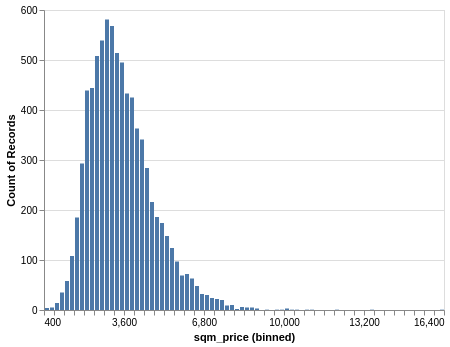

In [5]:
alt.Chart(d).mark_bar().encode(
    alt.X("sqm_price:Q", 
            bin=alt.BinParams(maxbins=100)),
    y="count()"
)

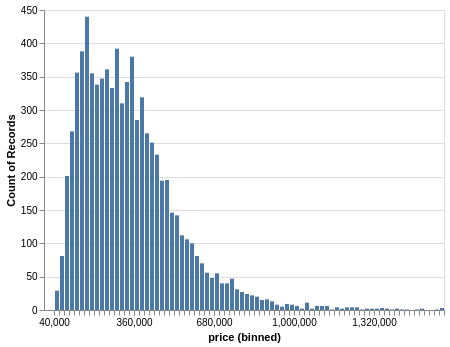

In [6]:
alt.Chart(d[d.price <= 1600000]).mark_bar().encode(
    alt.X("price:Q",
         bin = alt.BinParams(maxbins=100),
         scale = alt.Scale(domain=(0, 1600000)) ),
    y="count()"
)

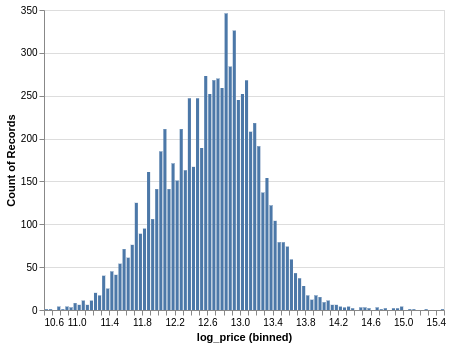

In [7]:
alt.Chart(d).mark_bar().encode(
    alt.X("log_price:Q",
         bin=alt.BinParams(maxbins=100)),
    y="count()"
)

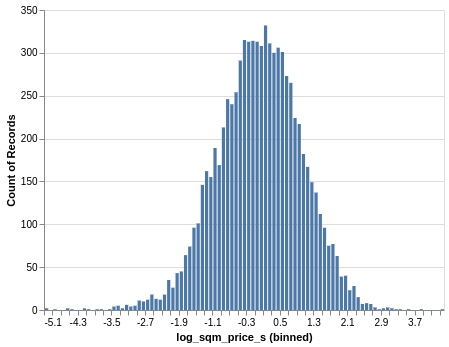

In [8]:
alt.Chart(d).mark_bar().encode(
    alt.X("log_sqm_price_s:Q", 
            bin=alt.BinParams(maxbins=100)),
    y="count()"
)

$$\begin{align*}
log(sqm/price) &\sim \text{Normal}(\mu, \sigma)\\
\mu &\sim \text{Normal}(0, 10)\\
\sigma &\sim \text{HalfCauchy}(10)
\end{align*}$$

In [9]:
target = "log_price_s"

In [10]:
with pm.Model() as intercept_normal:
    mu = pm.Normal("mu", mu=0, sd=10)
    sigma = pm.HalfNormal("sigma", sd=10)
    
    y = pm.Normal("y", mu=mu, sd=sigma, observed = d[target])
    
    trace = pm.sample()

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (2 chains in 2 jobs)
NUTS: [sigma, mu]
Sampling 2 chains: 100%|██████████| 2000/2000 [00:01<00:00, 1017.84draws/s]
The acceptance probability does not match the target. It is 0.8795999542168703, but should be close to 0.8. Try to increase the number of tuning steps.


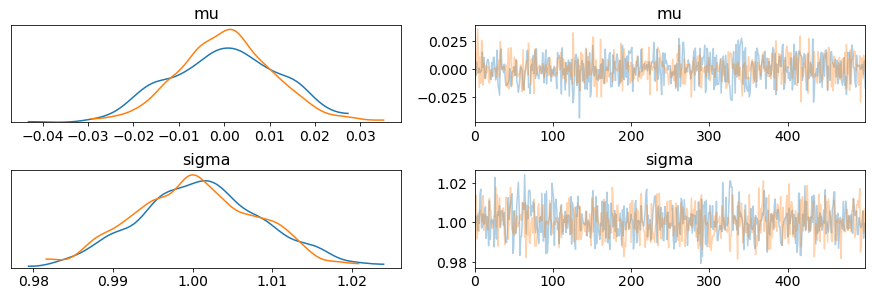

In [11]:
az.plot_trace(trace)
plt.show()

In [12]:
with pm.Model() as intercept_student:
    mu = pm.Normal("mu", mu=0, sd=20)
    sigma = pm.HalfCauchy("sigma", 10)
    nu = pm.Gamma("nu", alpha=2, beta=0.1)
    
    y = pm.StudentT("y", mu=mu, sd=sigma, nu=nu, observed=d[target])
    
    trace = pm.sample()

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (2 chains in 2 jobs)
NUTS: [nu, sigma, mu]
Sampling 2 chains: 100%|██████████| 2000/2000 [00:07<00:00, 283.54draws/s]


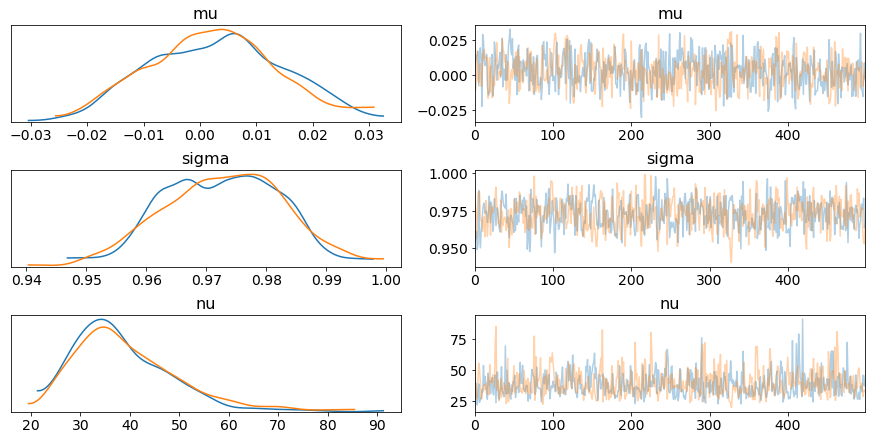

In [13]:
az.plot_trace(trace)
plt.show()

$$\begin{align*}
log(sqm/price) &\sim \text{Normal}(\mu, \sigma)\\
\mu &= \alpha + \beta \;\text{living_space}\\
\alpha &\sim \text{Normal}(0, 10) \\
\beta &\sim \text{Normal}(0, 1) \\
\sigma &\sim \text{HalfCauchy}(10)
\end{align*}$$

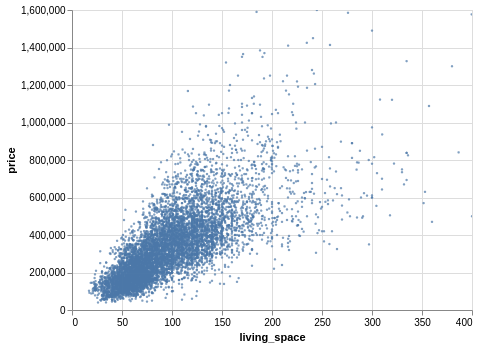

In [14]:
alt.Chart(d).mark_circle(clip=True,
                        opacity=0.7,
                        size=5).encode(
    x = alt.X("living_space", scale=alt.Scale(domain=(0, 400))),
    y = alt.Y("price", scale=alt.Scale(domain=(0, 1500000)))
)

In [15]:
with pm.Model() as lin_normal:
    alpha = pm.Normal("alpha", mu=0, sd=10)
    beta = pm.Normal("beta", mu=0, sd=1)
    mu = alpha + beta*d["living_space_s"]
    
    sigma = pm.HalfCauchy("sigma", 5)
    y = pm.Normal("y", mu=mu, sd=sigma, observed=d[target])
    trace = pm.sample()

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (2 chains in 2 jobs)
NUTS: [sigma, beta, alpha]
Sampling 2 chains: 100%|██████████| 2000/2000 [00:02<00:00, 682.73draws/s]


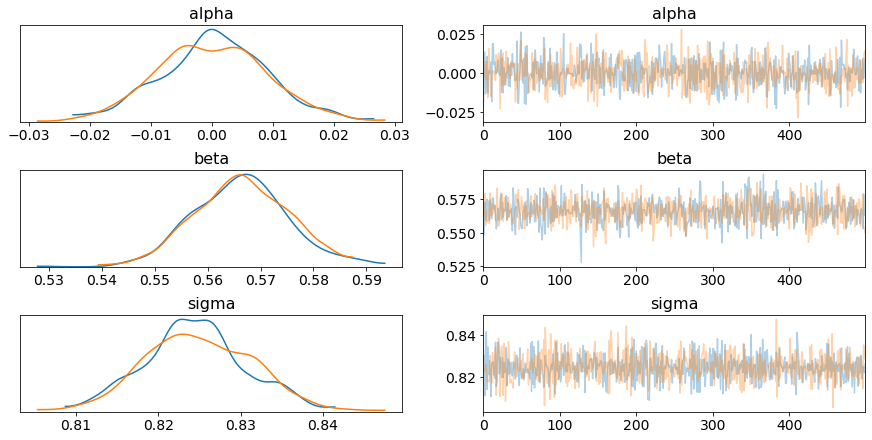

In [16]:
az.plot_trace(trace)
plt.show()

In [17]:
with pm.Model() as lin_student:
    alpha = pm.Normal("alpha", mu=0, sd=10)
    beta = pm.Normal("beta", mu=0, sd=1)
    mu = alpha + beta*d["living_space_s"]
    
    sigma = pm.HalfCauchy("sigma", 5)
    nu = pm.Gamma("nu", alpha=2, beta=0.1)
    y = pm.StudentT("y", nu=nu, mu=mu, sd=sigma, observed=d[target])
    trace = pm.sample(random_seed=2405)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (2 chains in 2 jobs)
NUTS: [nu, sigma, beta, alpha]
Sampling 2 chains: 100%|██████████| 2000/2000 [00:07<00:00, 283.71draws/s]


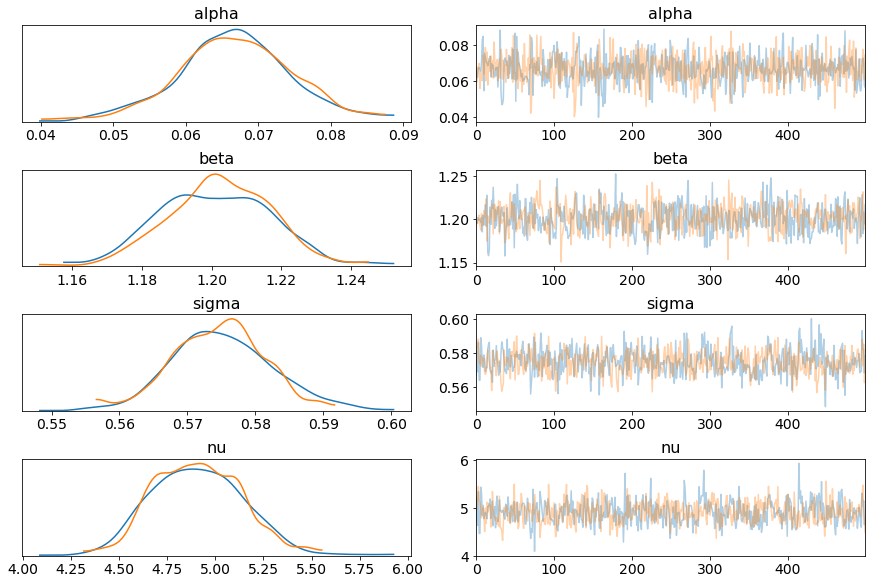

In [18]:
az.plot_trace(trace)
plt.show()